In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.io
import scanpy.external as scex
import sklearn.metrics
import seaborn as sns
from matplotlib import pyplot as plt

import sys
sys.path.insert(1, '../mhCompTiss/')

import scanpyHelpers as scH

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
#adata=sc.read(results_file_post)
#adata.uns['log1p'] = {"base":None}

Set up out properties

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, dpi_save=300, facecolor='white', format="svg", transparent=True)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-pac

scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.21.5 scipy==1.7.3 pandas==1.5.3 scikit-learn==1.2.2 statsmodels==0.13.5 python-igraph==0.10.4 pynndescent==0.5.10


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/umap/umap_.py:660: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()


In [4]:
%matplotlib inline

Set scanpy out-files

In [5]:
writeDir = "write/"

fileName = "pdacPdxMrtx"

resultsFile = writeDir + fileName + '.h5ad'       # final output
resultsFileTotal = writeDir + fileName + 'wImm.h5ad'       # final output
resultsFileQC = writeDir + fileName + '_QC.h5ad'  # post QC (pre-analysis) 

Set figure parameters

In [6]:
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=150, fontsize=10, format='png')
sc.settings.figdir = "figures/" + fileName + "/"
figName = fileName

In [7]:
adata = sc.read(resultsFile)

In [8]:
homology = pd.read_table("data/hgncHM_121.csv", sep=",")
mouseGenes = np.array(homology["mouse"])
humanGenes = np.array(homology["human"])
homology

,mouse,human
0,A1bg,A1BG
1,A1cf,A1CF
2,A2m,A2M
3,A3galt2,A3GALT2
4,A4galt,A4GALT
...,...,...
17271,Zyg11a,ZYG11A
17272,Zyg11b,ZYG11B
17273,Zyx,ZYX
17274,Zzef1,ZZEF1


In [9]:
sigGenes = pd.read_csv("data/basClaSigGenes.csv")
sigGenes = sigGenes[["scBasal","scClassical","EMT"]]

In [10]:
#set(sigGenes["basal"]).intersection(set(sigGenes["scBasal"]))

In [11]:
#set(sigGenes["classical"]).intersection(set(sigGenes["scClassical"]))

In [12]:
#set(sigGenes["scBasal"]).intersection(set(sigGenes["EMT"]))

In [13]:
#set(sigGenes["scClassical"]).intersection(set(sigGenes["EMT"]))

computing score 'scBasalScore'
    finished: added
    'scBasalScore', score of gene set (adata.obs).
    1142 total control genes are used. (0:00:00)
computing score 'scClassicalScore'
    finished: added
    'scClassicalScore', score of gene set (adata.obs).
    1147 total control genes are used. (0:00:00)
computing score 'EMTScore'
    finished: added
    'EMTScore', score of gene set (adata.obs).
    1140 total control genes are used. (0:00:00)
scBasalScore: 0.27036234671875464

scClassicalScore: 0.4034379244773705

EMTScore: 0.05663016988619038

   scBasalScore  scClassicalScore  EMTScore
0        0.1241            0.2792    0.0333
1        0.1101            0.2317    0.0199
2        0.1888            0.1558    0.0332
3        0.1369            0.0498    0.0291
4        0.1685            0.0934    0.0311
5        0.0100            0.3549    0.0126
6        0.1690            0.1681    0.0354


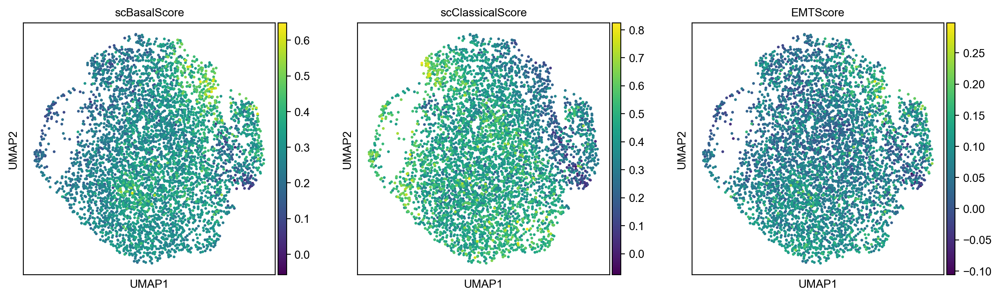

In [14]:
scoreNames, newBClabel, ogLabelScoreMed = scH.scoreAndLabel(adata, sigGenes, 
#                                                            labelOfSigGenes= ["basal","basal","classical","classical","EMT"],
                                                            labelOfSigGenes= ["basal","classical","EMT"],
                                                            ogLabel="leiden")#,translate=False, humanGenes=mouseGenes, mouseGenes=humanGenes )

sc.pl.umap(adata, color=scoreNames, ncols=3)


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


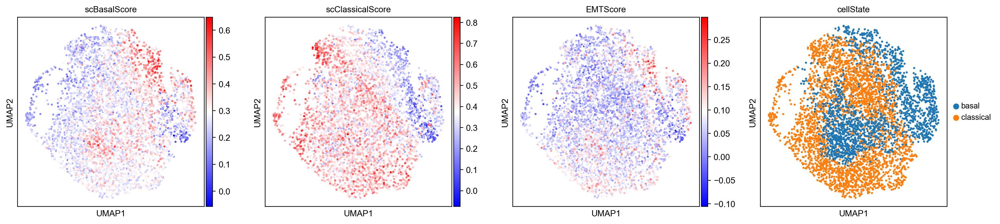

In [15]:
sc.pl.umap(adata, color=scoreNames+["cellState"],ncols=4,cmap="bwr")

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


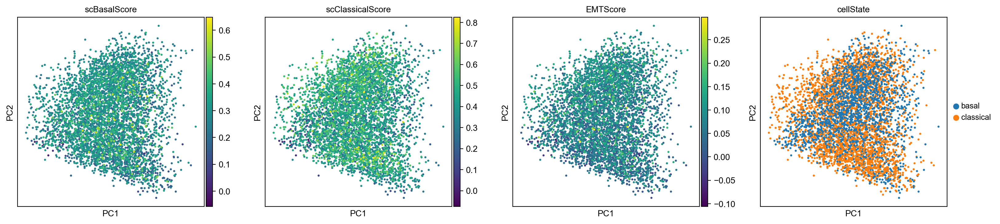

In [16]:
sc.pl.pca(adata, color=scoreNames+["cellState"],ncols=4)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


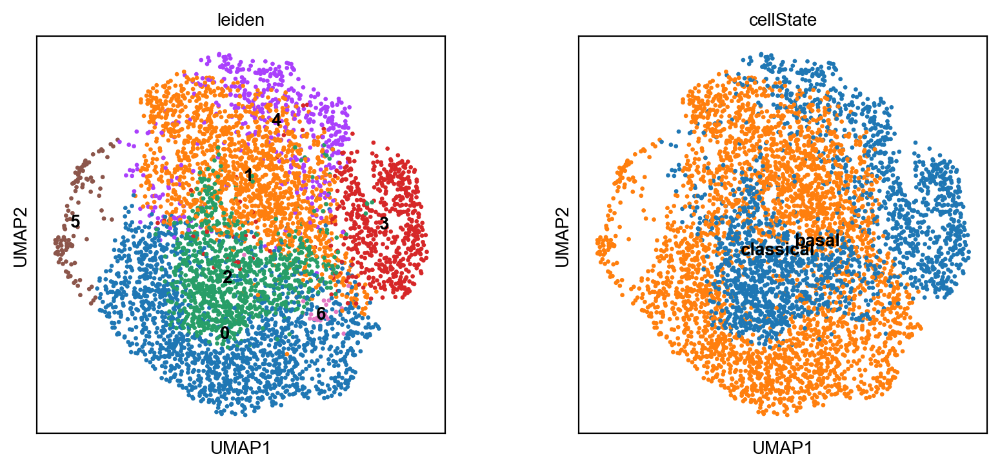

In [17]:
#sc.tl.leiden(adata, resolution=0.2)
sc.pl.umap(adata, color = ["leiden","cellState"], legend_loc="on data")

In [18]:
classLabDict = dict(zip(sigGenes.columns,["basal","classical","EMT"]))#"basal","classical",
markers = pd.DataFrame(np.empty((200*12,2), dtype="object"), columns=["genes", "clustName"])
for i,clust in enumerate(sigGenes.columns):
    for j,gene in enumerate(sigGenes.index):
        gene = sigGenes.loc[gene,clust]
        indexOver = np.where(humanGenes == gene)[0]
        if indexOver.size > 0:
            gene = mouseGenes[indexOver[0]]
        markers.iloc[i*200+j] = gene,classLabDict[clust]
        
markers = markers.dropna()
markers

,genes,clustName
0,KRT6A,basal
1,S100A2,basal
2,Krt13,basal
3,Krt17,basal
4,Ly6d,basal
...,...,...
577,Lum,EMT
578,Mfap5,EMT
579,Sgcg,EMT
580,Efemp2,EMT


In [19]:
markers = markers.drop_duplicates()
markers

,genes,clustName
0,KRT6A,basal
1,S100A2,basal
2,Krt13,basal
3,Krt17,basal
4,Ly6d,basal
...,...,...
577,Lum,EMT
578,Mfap5,EMT
579,Sgcg,EMT
580,Efemp2,EMT


In [20]:
adata

AnnData object with n_obs × n_vars = 5097 × 2098
    obs: 'MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'cellState_colors', 'decoupler_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase

In [21]:
import decoupler as dc

In [22]:
dc.run_ora(
    mat=adata,
    net=markers,
    source='clustName',
    target='genes',
    min_n=3,
    verbose=True
)

2 features of mat are empty, they will be removed.
Running ora on mat with 5097 samples and 22234 targets for 3 sources.


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5097/5097 [00:06<00:00, 749.19it/s]


In [23]:
acts = dc.get_acts(adata, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

acts

AnnData object with n_obs × n_vars = 5097 × 3
    obs: 'MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    uns: 'GMM_colors', 'cellState_colors', 'decoupler_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'tumor_colors', 'umap', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_p

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


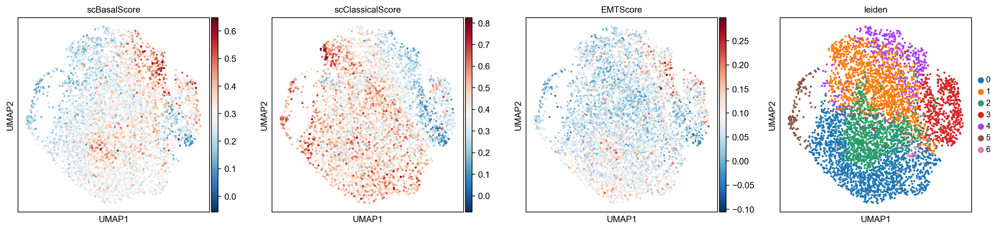

In [24]:
sc.pl.umap(acts, color=scoreNames+['leiden'], cmap='RdBu_r')

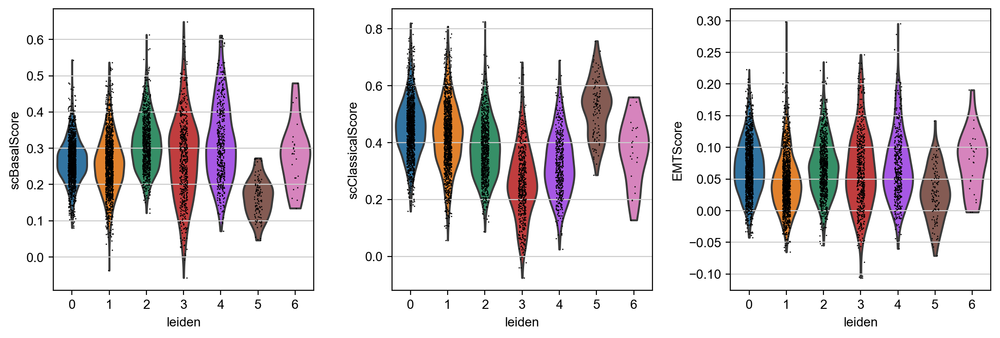

In [25]:
sc.pl.violin(acts, keys=scoreNames, groupby='leiden')

In [26]:
df = dc.rank_sources_groups(acts, groupby='leiden', reference='rest', method='t-test_overestim_var')
df

,group,reference,names,statistic,meanchange,pvals,pvals_adj
0,0,rest,EMT,17.028659,0.387342,8.837928e-62,2.651378e-61
1,0,rest,classical,11.495855,0.302371,5.873040e-30,8.809560e-30
2,0,rest,basal,-1.016074,-0.016256,3.096743e-01,3.096743e-01
3,1,rest,classical,-1.040305,-0.027235,2.982841e-01,2.982841e-01
4,1,rest,basal,-2.209081,-0.034743,2.724785e-02,4.087178e-02
5,1,rest,EMT,-5.166977,-0.109842,2.546521e-07,7.639563e-07
6,2,rest,basal,3.843454,0.079484,1.253969e-04,1.253969e-04
7,2,rest,EMT,-4.203027,-0.110981,2.762862e-05,4.144292e-05
8,2,rest,classical,-5.221319,-0.164913,1.979939e-07,5.939817e-07
9,3,rest,basal,3.023096,0.084453,2.559853e-03,2.559853e-03


In [27]:
n_ctypes = 3
ctypes_dict = df.groupby('group').head(n_ctypes).groupby('group')['names'].apply(lambda x: list(x)).to_dict()
ctypes_dict

{'0': ['EMT', 'classical', 'basal'],
 '1': ['classical', 'basal', 'EMT'],
 '2': ['basal', 'EMT', 'classical'],
 '3': ['basal', 'classical', 'EMT'],
 '4': ['basal', 'classical', 'EMT'],
 '5': ['classical', 'basal', 'EMT'],
 '6': ['basal', 'EMT', 'classical']}

In [28]:
#sc.pl.matrixplot(acts, ctypes_dict, 'leiden', dendrogram=True, standard_scale='var',colorbar_title='Z-scaled scores', cmap='RdBu_r')

In [29]:
annotation_dict = df.groupby('group').head(1).set_index('group')['names'].to_dict()
annotation_dict

{'0': 'EMT',
 '1': 'classical',
 '2': 'basal',
 '3': 'basal',
 '4': 'basal',
 '5': 'classical',
 '6': 'basal'}

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


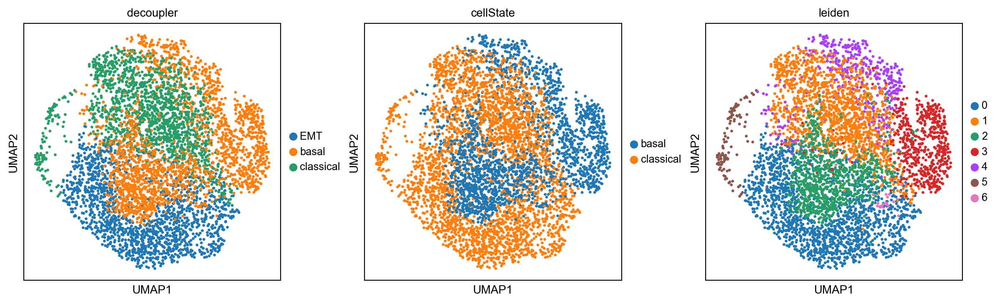

In [30]:
# Add cell type column based on annotation
adata.obs['decoupler'] = [annotation_dict[clust] for clust in adata.obs['leiden']]

# Visualize
sc.pl.umap(adata, color=['decoupler','cellState', "leiden"])

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


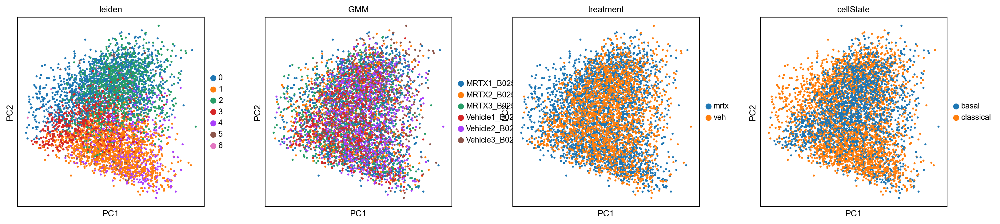

In [31]:
sc.pl.pca(adata, color=["leiden","GMM","treatment","cellState"],ncols=4)

In [32]:
scH.addIndvLabel(adata, [f"{sigName}Score" for sigName in sigGenes.columns], obsLabel="zsig", cutoff=0.5)

AnnData object with n_obs × n_vars = 5097 × 2098
    obs: 'MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'cellState_colors', 'decoupler_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


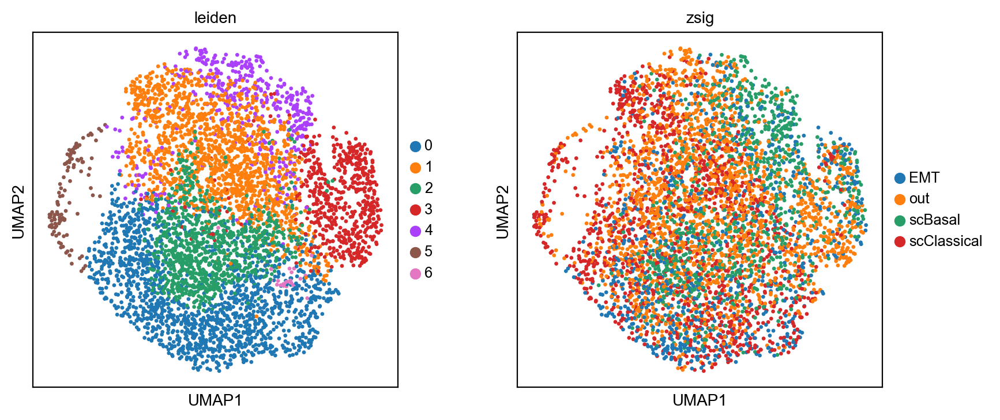

In [33]:
sc.pl.umap(adata, color=["leiden","zsig"])#, legend_loc="on data")

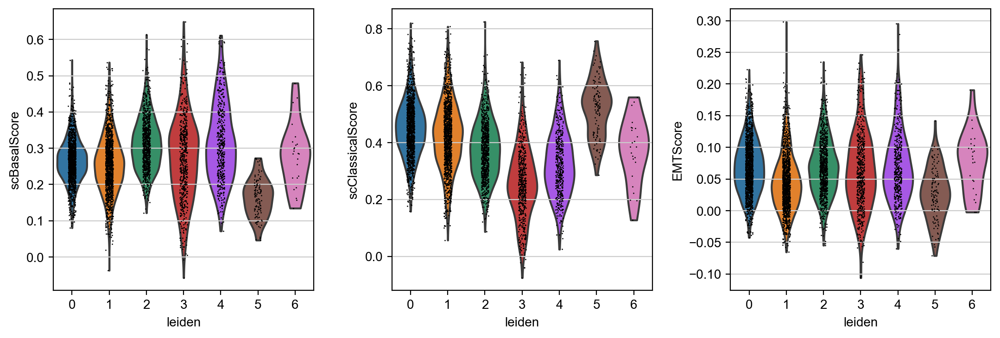

In [34]:
sc.pl.violin(adata, keys=scoreNames, groupby='leiden')

In [35]:
adata.write(resultsFile)
adata

AnnData object with n_obs × n_vars = 5097 × 2098
    obs: 'MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'cellState_colors', 'decoupler_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase

In [36]:
resultsFile

'write/pdacPdxMrtx.h5ad'

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


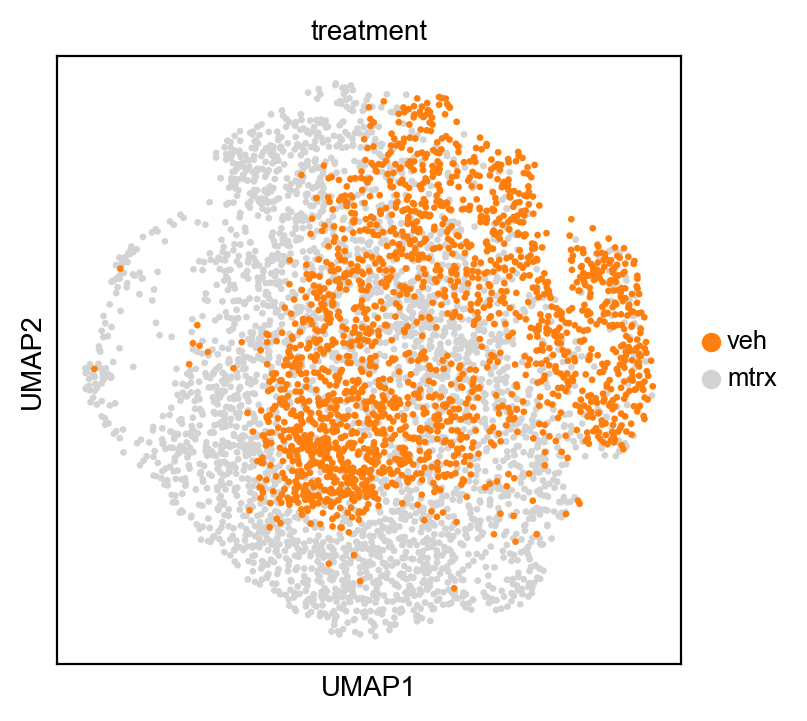

In [37]:
ax=sc.pl.umap(adata,color=['treatment'],groups=['veh'], show=False)

# We can change the 'NA' in the legend that represents all cells outside of the
# specified groups
legend_texts=ax.get_legend().get_texts()
# Find legend object whose text is "NA" and change it
for legend_text in legend_texts:
    if legend_text.get_text()=="NA":
        legend_text.set_text('mtrx')

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

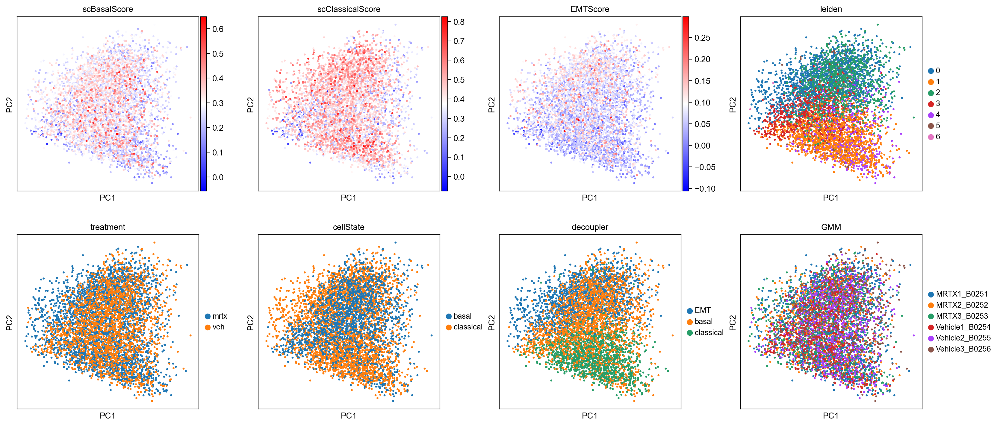

In [38]:
#sc.pl.umap(acts, color=scoreNames+['leiden'], cmap='RdBu_r')
sc.pl.pca(adata, color=scoreNames+["leiden","treatment","cellState","decoupler","GMM"],ncols=4, cmap="bwr")

In [39]:
adata.uns["treatment_colors"] = np.array(['#ff7f0e','#1f77b4'])

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

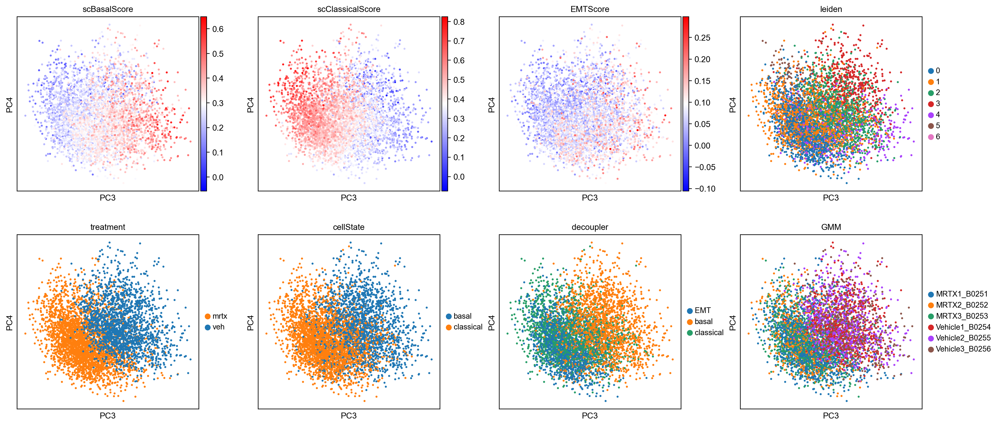

In [40]:
#sc.pl.umap(acts, color=scoreNames+['leiden'], cmap='RdBu_r')
sc.pl.pca(adata, color=scoreNames+["leiden","treatment","cellState","decoupler","GMM"],ncols=4, cmap="bwr", dimensions=[2,3])

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

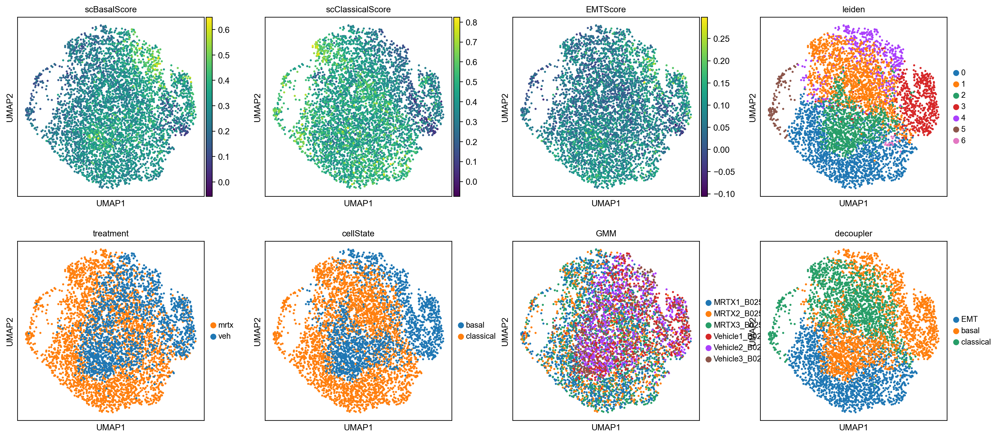

In [41]:
sc.pl.umap(adata, color=scoreNames+["leiden","treatment","cellState","GMM","decoupler"],ncols=4)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

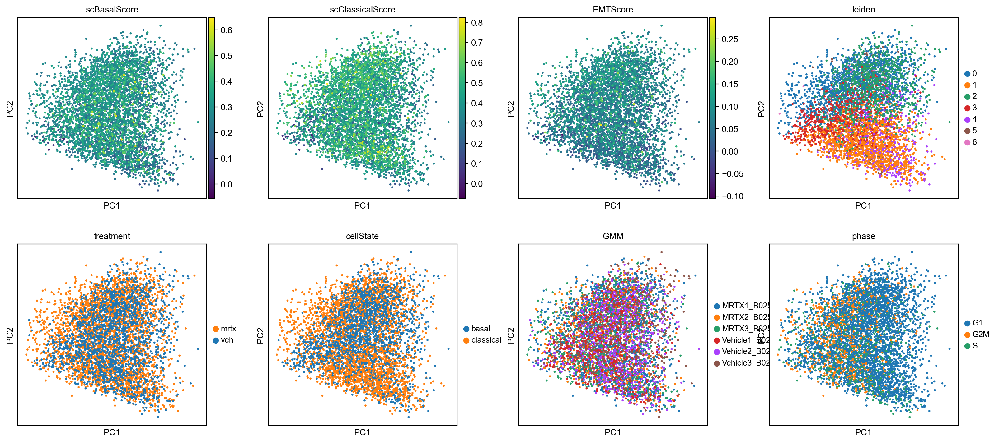

In [42]:
sc.pl.pca(adata, color=scoreNames+["leiden","treatment","cellState","GMM","phase"],ncols=4)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

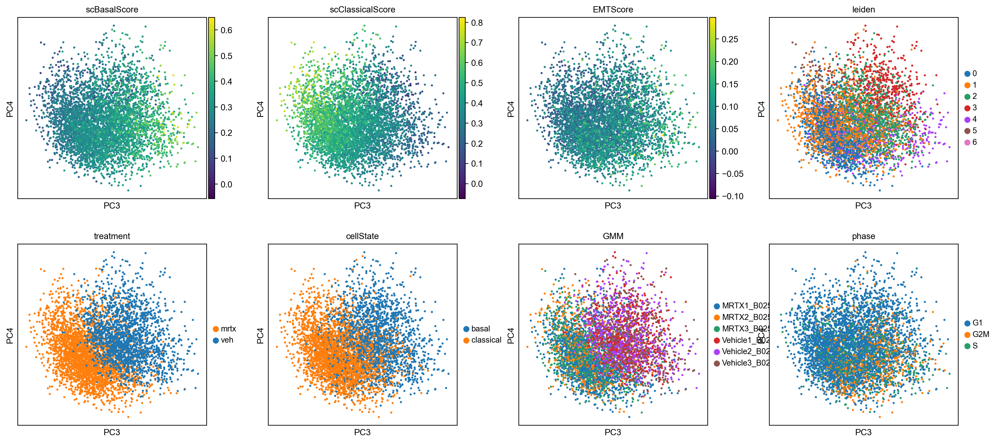

In [43]:
sc.pl.pca(adata, color=scoreNames+["leiden","treatment","cellState","GMM","phase"],ncols=4,dimensions=[(2,3)])

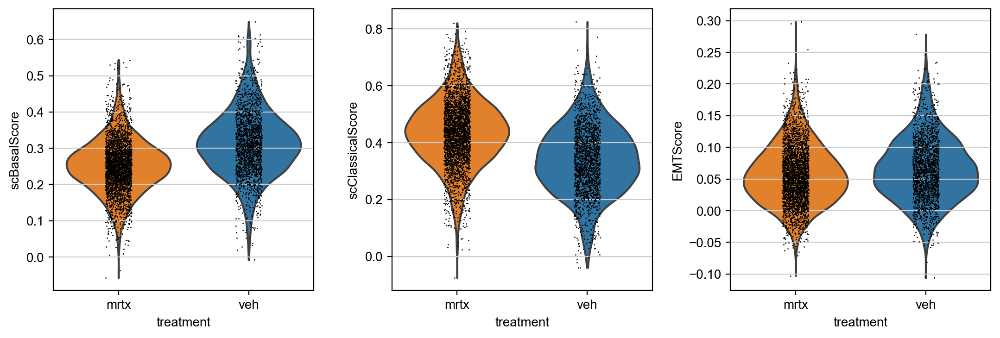

In [44]:
sc.pl.violin(adata, keys=scoreNames, groupby="treatment")

In [45]:
adata.write(resultsFile)

In [46]:
adata = sc.read(resultsFile)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


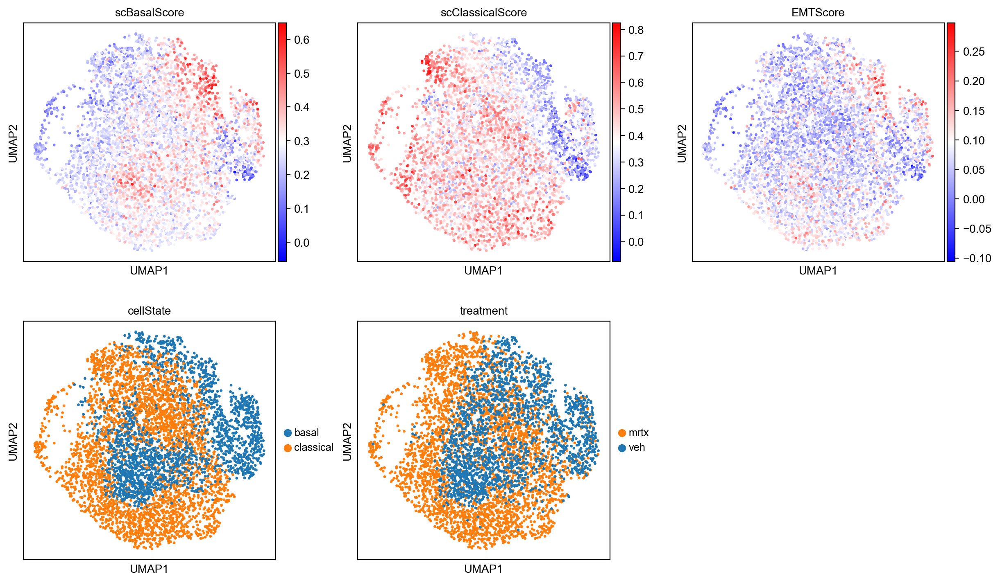

In [47]:
sc.pl.umap(adata, color=scoreNames+["cellState","treatment"],ncols=3,cmap="bwr")

In [48]:
from sklearn.metrics.pairwise import cosine_similarity
from scipy import stats

alpha=0.01
trtClass = adata[adata.obs.treatment=="mrtx"].obs["scClassicalScore"]
vehClass = adata[adata.obs.treatment=="veh"].obs["scClassicalScore"]

u_statistic, p_value = stats.mannwhitneyu(trtClass,vehClass, alternative="greater")
if p_value < alpha:
    print("Reject the null hypothesis: The means are significantly different.")
else:
    print("Fail to reject the null hypothesis: No significant difference detected.")

print(f"mannwhitneyu’s u-statistic: {u_statistic:.4f}, p-value: {p_value:.4f}")

Reject the null hypothesis: The means are significantly different.
mannwhitneyu’s u-statistic: 4375954.0000, p-value: 0.0000


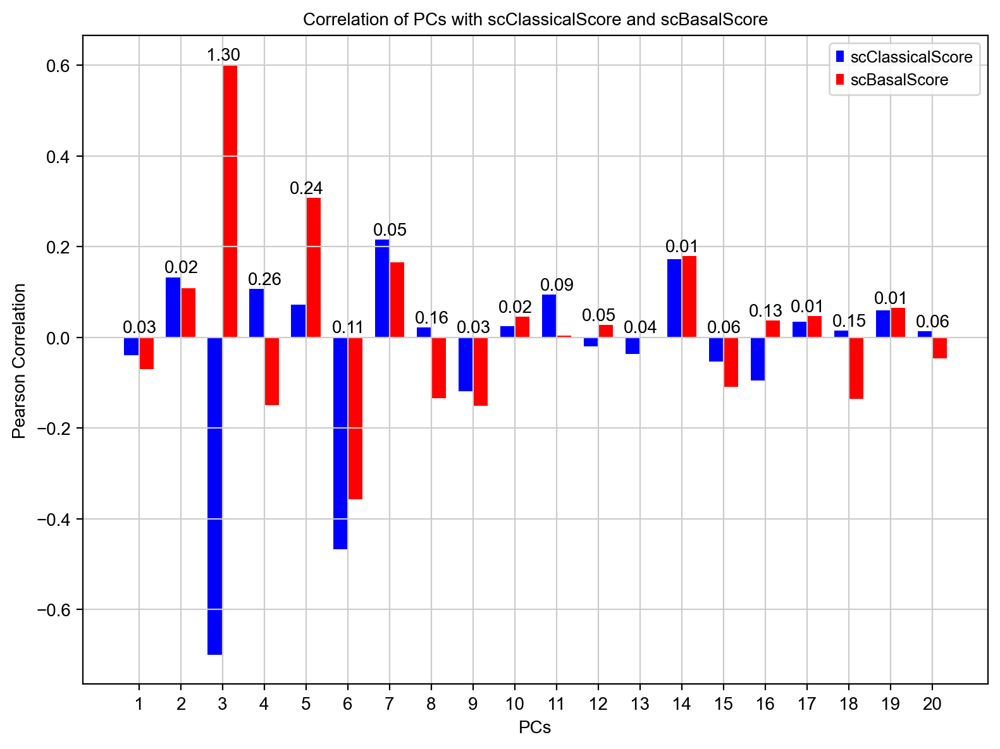

array([ 2,  3,  4,  7, 17, 15,  5, 10, 19, 14,  6, 11, 12,  8,  0,  1,  9,
       16, 13, 18])

In [49]:
scH.findDiffPCs(adata, label1="scClassicalScore", label2="scBasalScore", lenPCs=20, show=True)

In [50]:
adata

AnnData object with n_obs × n_vars = 5097 × 2098
    obs: 'MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'cellState_colors', 'decoupler_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase

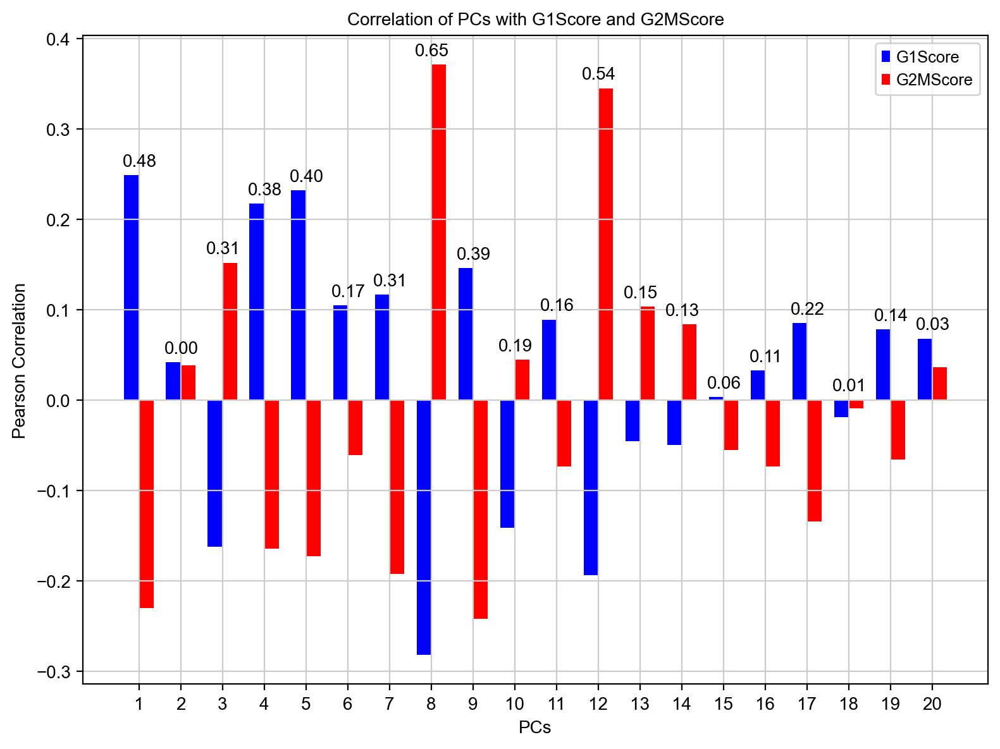

array([ 7, 11,  0,  4,  8,  3,  2,  6, 16,  9,  5, 10, 12, 18, 13, 15, 14,
       19, 17,  1])

In [51]:
scH.findDiffPCs(adata, label1="phase", label2=None, lenPCs=20, show=True)

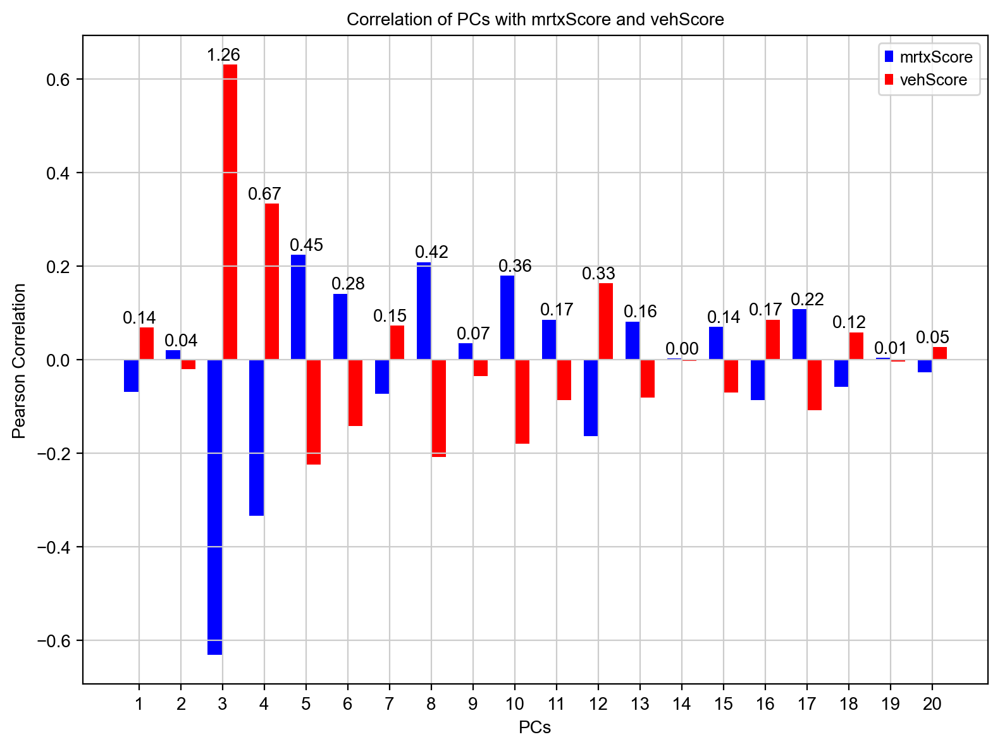

array([ 2,  3,  4,  7,  9, 11,  5, 16, 15, 10, 12,  6, 14,  0, 17,  8, 19,
        1, 18, 13])

In [52]:
scH.findDiffPCs(adata, label1="treatment", label2=None, lenPCs=20, show=True)

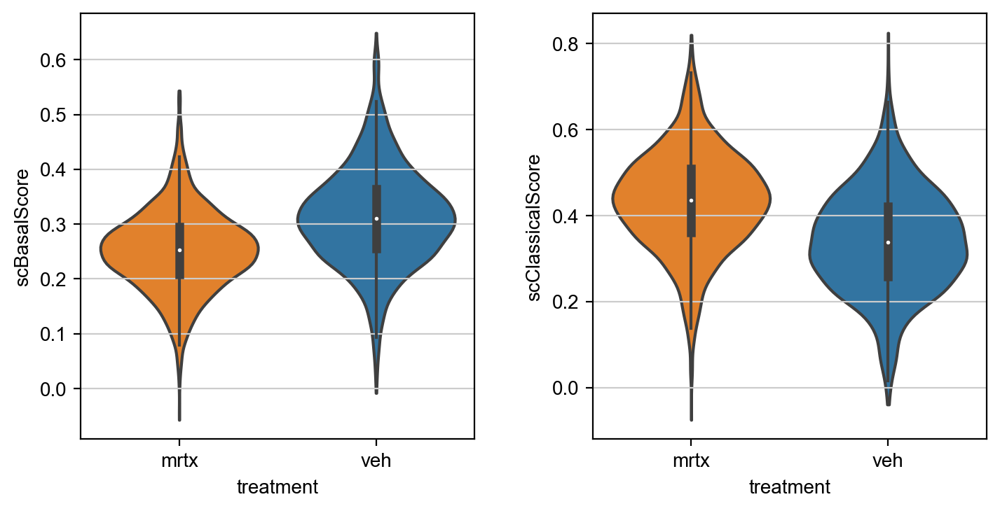

In [53]:
sc.pl.violin(adata,  keys=["scBasalScore", "scClassicalScore"], groupby="treatment",  inner = "box", stripplot=False)

In [54]:
adata = sc.read(resultsFile)
adata

AnnData object with n_obs × n_vars = 5097 × 2098
    obs: 'MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'cellState_colors', 'decoupler_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase

computing density on 'pca'
--> added
    'pca_density_treatment', densities (adata.obs)
    'pca_density_treatment_params', parameter (adata.uns)


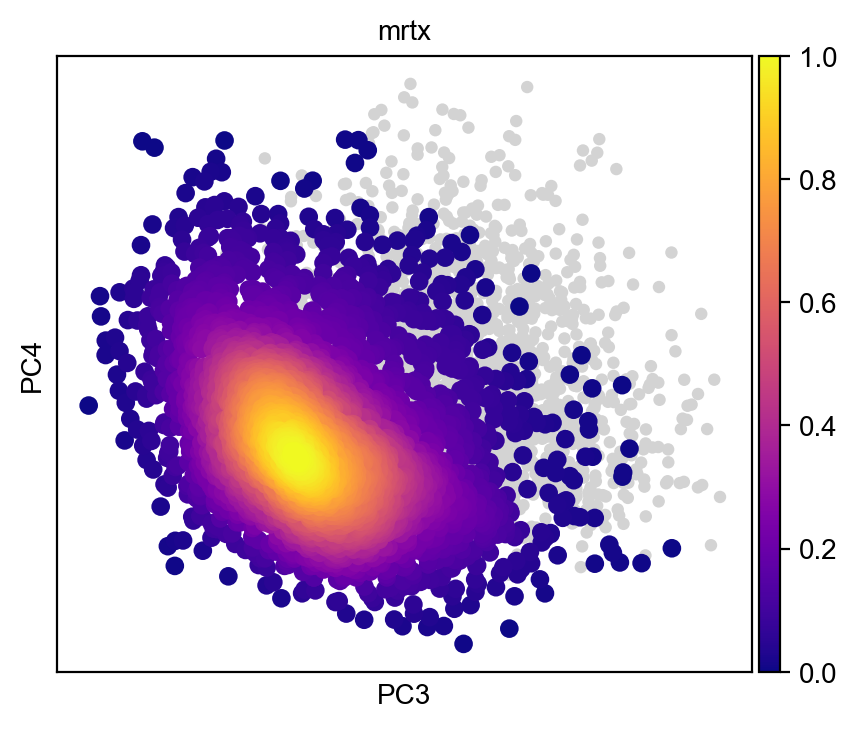

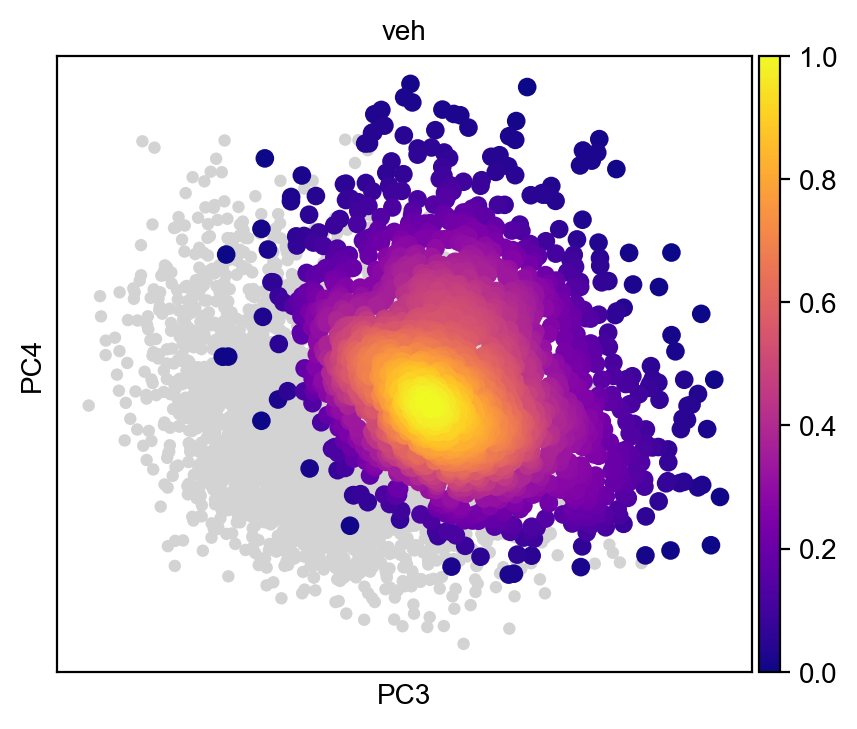

In [55]:
sc.tl.embedding_density(adata, basis='pca', groupby="treatment", components=[3,4])
sc.pl.embedding_density(adata, basis='pca', key='pca_density_treatment', group="mrtx", color_map="plasma")
sc.pl.embedding_density(adata, basis='pca', key='pca_density_treatment', group="veh", color_map="plasma")

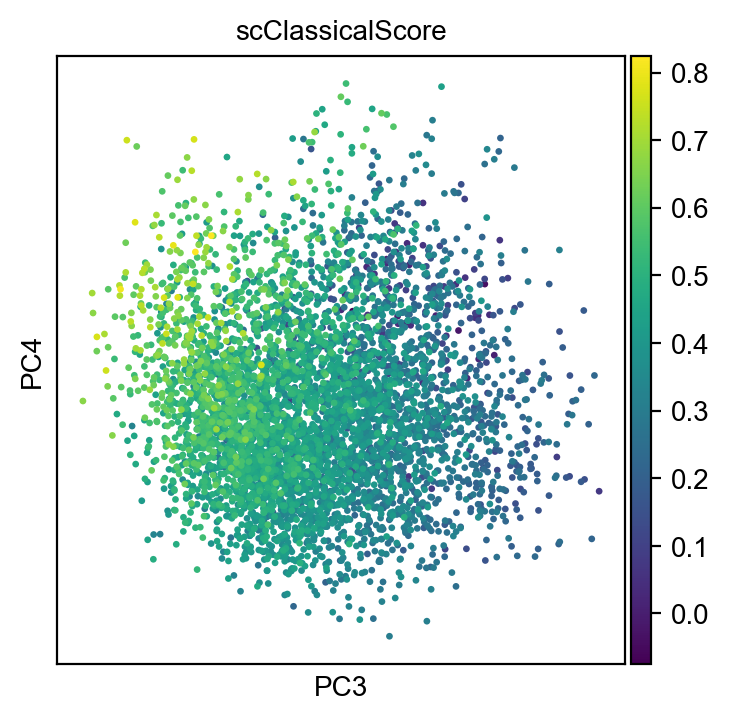

In [56]:
sc.pl.pca(adata, color=["scClassicalScore"],dimensions=[(2,3)])

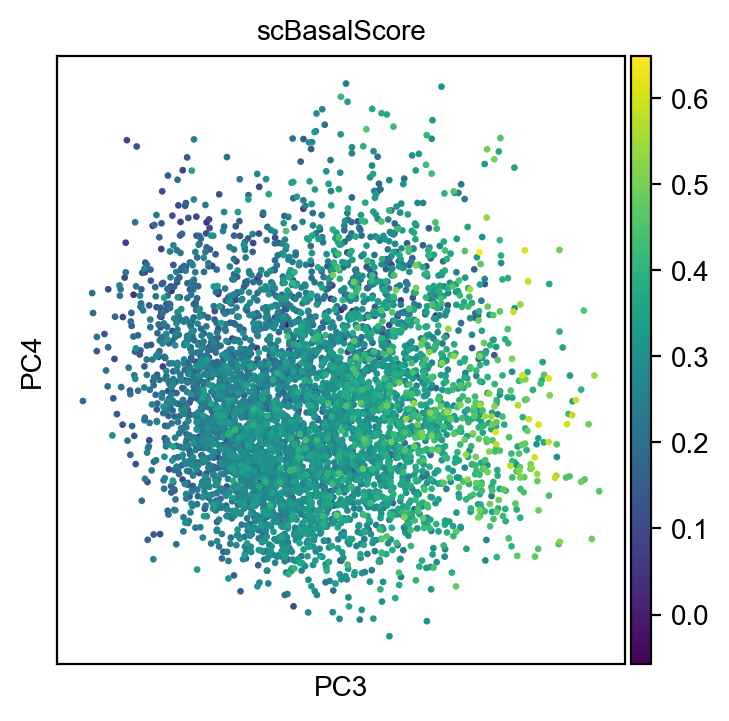

In [57]:
sc.pl.pca(adata, color=["scBasalScore"],dimensions=[(2,3)])

In [58]:
markers = ['Dusp6',  'Etv1', 'Etv5', 'Ccnd1', 'Spry2']
mouselist = list(homology["mouse"].values)
humanMarkers = [homology.iloc[mouselist.index(g),1] for g in markers]

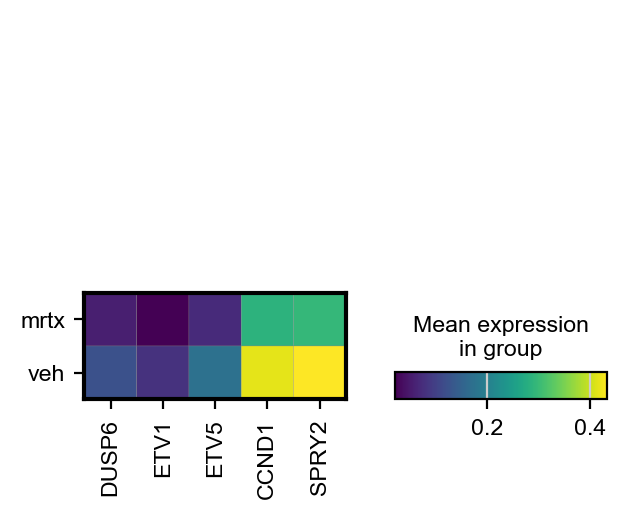

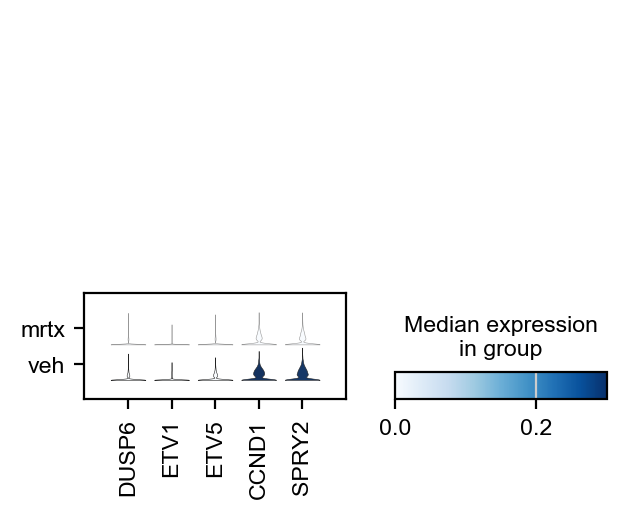

In [59]:
sc.pl.MatrixPlot(adata, humanMarkers, groupby="treatment").show()
sc.pl.stacked_violin(adata, humanMarkers, groupby="treatment")

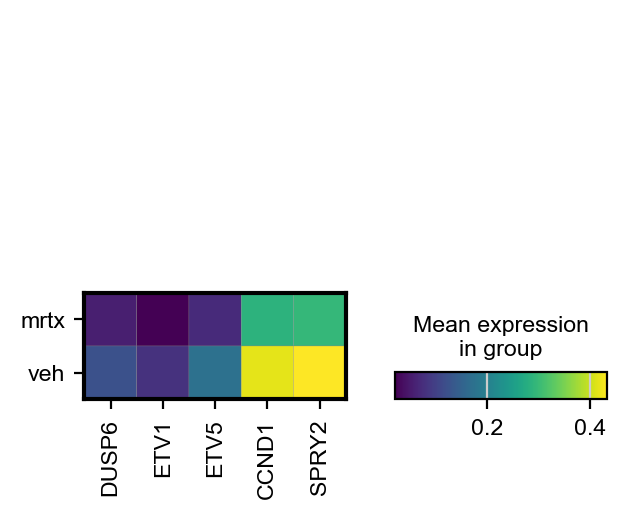

In [60]:
sc.pl.MatrixPlot(adata, humanMarkers, groupby="treatment").show()

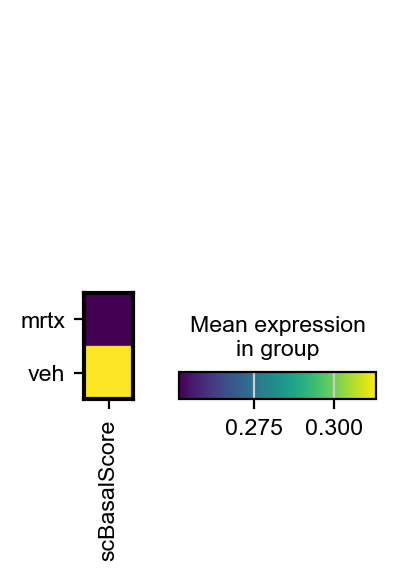

In [61]:
sc.pl.MatrixPlot(adata, ["scBasalScore"], groupby="treatment").show()

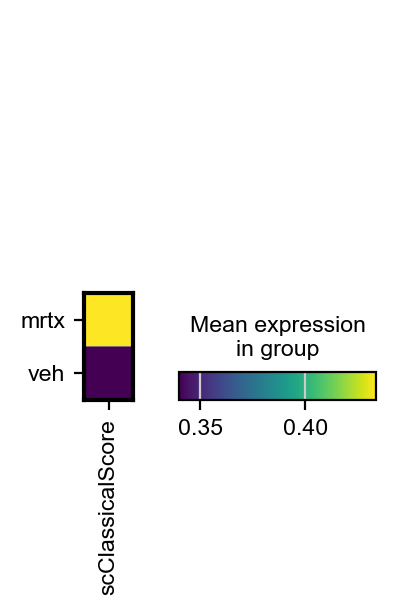

In [62]:
sc.pl.MatrixPlot(adata, ["scClassicalScore"], groupby="treatment").show()

In [63]:
plt.rcParams["axes.grid"] = False


In [64]:
adataM = adata[adata.obs["treatment"]=="mrtx"]
huMarkGexMr = np.asarray(adataM.raw.to_adata()[:,humanMarkers].X.todense()).T
huMarkGexMr = huMarkGexMr[:,np.argsort(adataM.obsm["X_pca"][:,2])]

adataV = adata[adata.obs["treatment"]=="veh"]
huMarkGexVe = np.asarray(adataV.raw.to_adata()[:,humanMarkers].X.todense()).T
huMarkGexVe = huMarkGexVe[:,np.argsort(adataV.obsm["X_pca"][:,2])]

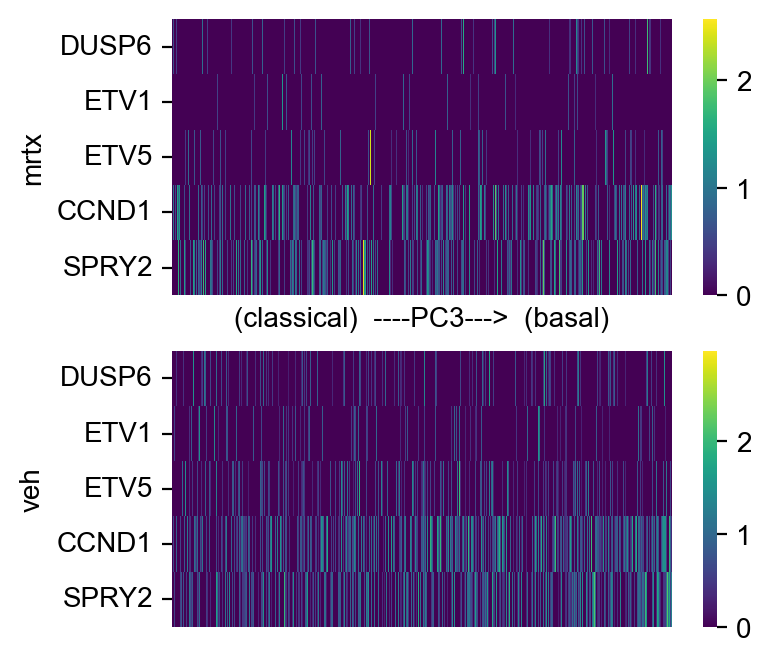

In [65]:
fig, ax = plt.subplots(2,1)

sns.heatmap(huMarkGexMr, yticklabels=humanMarkers ,cmap="viridis",xticklabels=[], ax=ax[0])   
ax[0].set_xlabel("(classical)  ----PC3--->  (basal)")
ax[0].set_ylabel("mrtx")

sns.heatmap(huMarkGexVe, yticklabels=humanMarkers ,cmap="viridis",xticklabels=[], ax=ax[1])   
#ax[1].set_xlabel("--PC3-->")
ax[1].set_ylabel("veh")

plt.show()

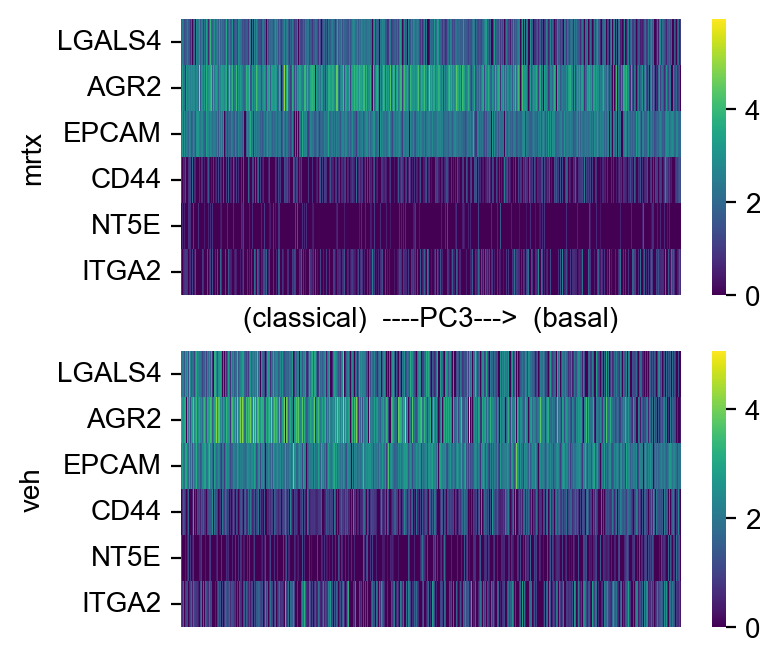

In [66]:
fig, ax = plt.subplots(2,1)
basClaMarkers = ["LGALS4","AGR2","EPCAM","CD44","NT5E","ITGA2"]
huMarkGexMr = np.asarray(adataM.raw.to_adata()[:,basClaMarkers].X.todense()).T
huMarkGexMr = huMarkGexMr[:,np.argsort(adataM.obsm["X_pca"][:,2])]
huMarkGexVe = np.asarray(adataV.raw.to_adata()[:,basClaMarkers].X.todense()).T
huMarkGexVe = huMarkGexVe[:,np.argsort(adataV.obsm["X_pca"][:,2])]

sns.heatmap(huMarkGexMr, yticklabels=basClaMarkers ,cmap="viridis",xticklabels=[], ax=ax[0])   
ax[0].set_xlabel("(classical)  ----PC3--->  (basal)")
ax[0].set_ylabel("mrtx")

sns.heatmap(huMarkGexVe, yticklabels=basClaMarkers ,cmap="viridis",xticklabels=[], ax=ax[1])   
#ax[1].set_xlabel("--PC3-->")
ax[1].set_ylabel("veh")

plt.show()

<Axes: >

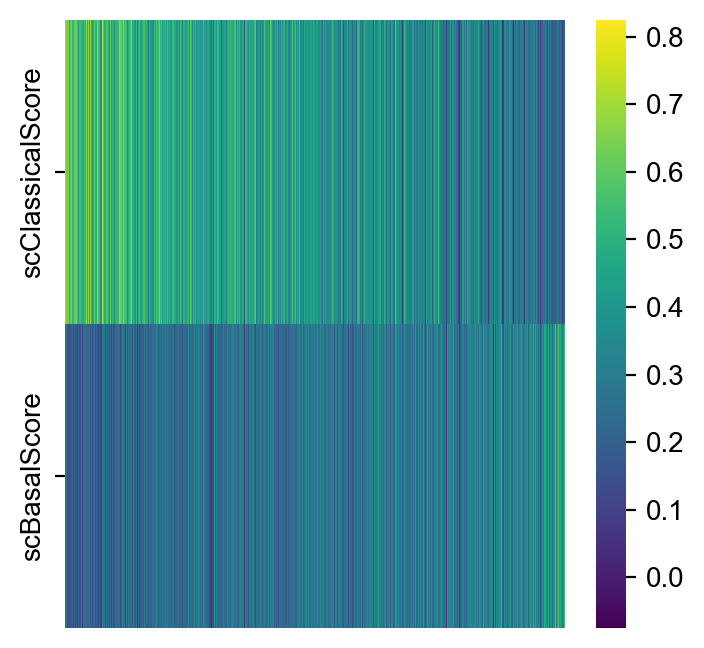

In [67]:
basClas = np.asarray(adata.obs[["scClassicalScore","scBasalScore"]].values).T
basClas = basClas[:,np.argsort(adata.obsm["X_pca"][:,2])]
sns.heatmap(basClas, yticklabels=["scClassicalScore","scBasalScore"] ,cmap="viridis",xticklabels=[])        

In [95]:
adata.obs["BasalNorm"] = adata.obs["scBasalScore"]/np.linalg.norm(adata.obs["scBasalScore"])
adata.obs["BasalNormZ"] = adata.obs["BasalNorm"]-np.mean(adata.obs["BasalNorm"])
adata.obs["ClassicalNorm"] = adata.obs["scClassicalScore"]/np.linalg.norm(adata.obs["scClassicalScore"])
adata.obs["ClassicalNormZ"] = adata.obs["ClassicalNorm"]-np.mean(adata.obs["ClassicalNorm"])


In [92]:
min(adata.obs["BasalNorm"]),max(adata.obs["BasalNorm"]),np.mean(adata.obs["BasalNorm"])

(-0.002785803051847533, 0.03159536387221839, 0.013382409298726356)

In [78]:
np.linalg.norm(adata.obs["scBasalScore"])

20.533090444401374

In [94]:
min(adata.obs["ClassicalNorm"]),max(adata.obs["ClassicalNorm"]),np.mean(adata.obs["ClassicalNorm"])

(-0.0025067774720896633, 0.027636567864464483, 0.013351934289722806)

In [79]:
np.linalg.norm(adata.obs["scClassicalScore"])

29.836670480629806

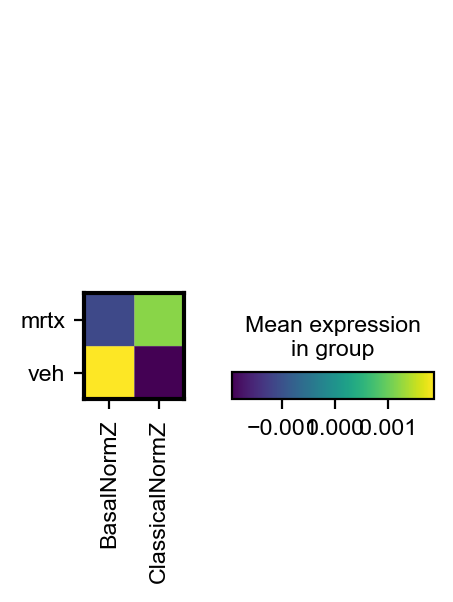

In [98]:
sc.pl.MatrixPlot(adata, ["BasalNormZ","ClassicalNormZ"], groupby="treatment").show()

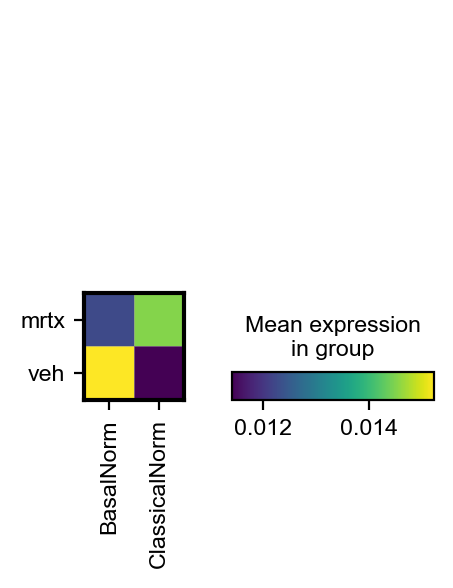

In [69]:
sc.pl.MatrixPlot(adata, ["BasalNorm","ClassicalNorm"], groupby="treatment").show()

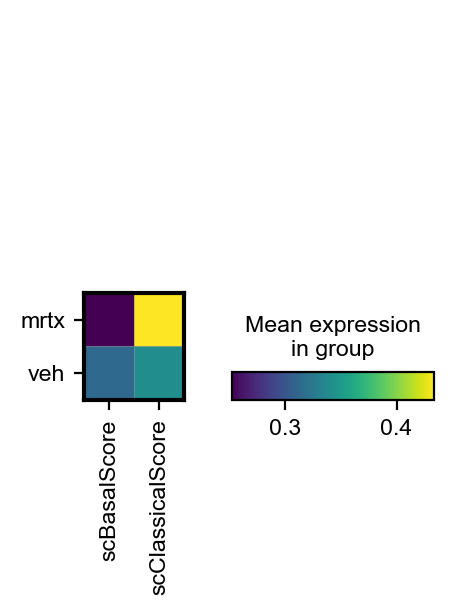

In [99]:
sc.pl.MatrixPlot(adata, ["scBasalScore","scClassicalScore"], groupby="treatment").show()

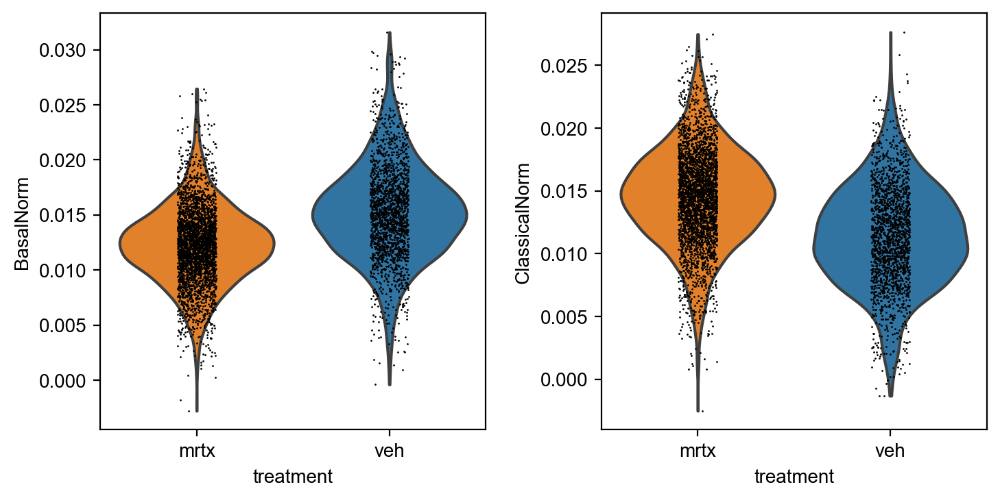

In [71]:
sc.pl.violin(adata, ["BasalNorm","ClassicalNorm"], groupby="treatment")

ranking genes
    finished: added to `.uns['clasbas']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


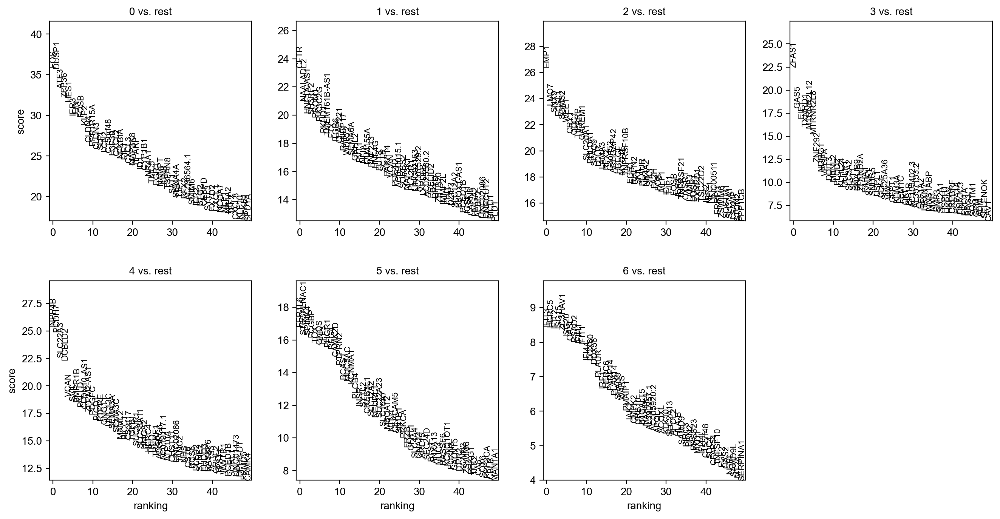

In [72]:
sc.tl.rank_genes_groups(adata, 'cellState', method='wilcoxon', use_raw=True,key_added='clasbas')
#sc.tl.filter_rank_genes_groups(adata, groupby="leiden", use_raw=False,
#                                   key_added='rank_genes_groups_filtered', 
#                                   min_in_group_fraction=0.25, min_fold_change=1, max_out_group_fraction=0.5, compare_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=50, sharey=False)

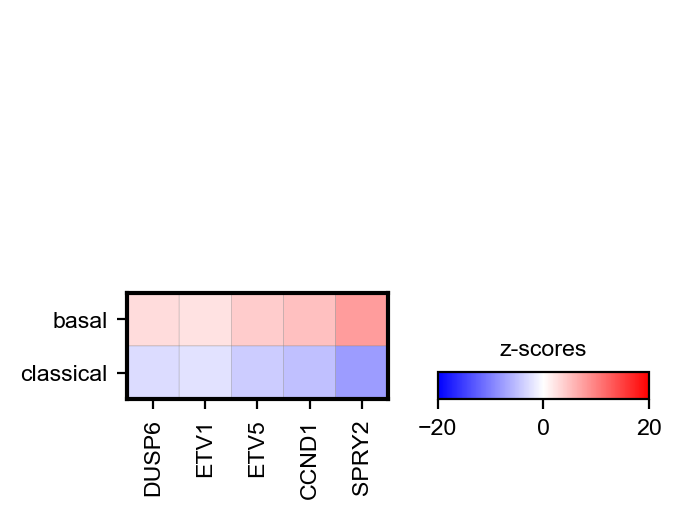

In [73]:
sc.pl.rank_genes_groups_matrixplot(adata, key = 'clasbas', var_names=humanMarkers, 
                                   values_to_plot="scores", cmap='bwr', vmin=-20, vmax=20, colorbar_title='z-scores', dendrogram = False)

In [74]:
allGenes = adata.raw.to_adata().var_names
markInd = [(g in humanMarkers) for g in allGenes]

In [75]:
adata.uns['rank_genes_groups']#["scores"][markInd]

{'logfoldchanges': array([( 2.2453895,  1.6899903,  2.0427883,  1.4287568 ,  2.158739 ,  6.7277894,  8.055436 ),
        ( 2.158523 ,  1.0798125,  1.3240616,  1.1819134 ,  2.3573902,  3.879321 ,  7.7649693),
        ( 2.0406687,  1.2704083,  1.3777726,  0.87492657,  2.389122 ,  6.991059 ,  9.041265 ),
        ...,
        (-1.2514405, -2.4952466, -1.4718786, -2.2377474 , -2.561904 , -2.4067235, -2.3730252),
        (-1.0371467, -2.462479 , -1.1806453, -3.546757  , -2.1542883, -2.9944704, -2.1971276),
        (-0.992084 , -1.2961717, -3.129605 , -2.3689294 , -3.6148717, -2.7690878, -1.8351679)],
       dtype=[('0', '<f4'), ('1', '<f4'), ('2', '<f4'), ('3', '<f4'), ('4', '<f4'), ('5', '<f4'), ('6', '<f4')]),
 'names': array([('FOS', 'CFTR', 'EMP1', 'ZFAS1', 'INPP4B', 'FER1L6', 'IFIT3'),
        ('DUSP1', 'NAALADL2', 'LMO7', 'GAS5', 'PCDH7', 'ST6GALNAC1', 'HERC5'),
        ('ATF3', 'HNF1A-AS1', 'SNX9', 'EIF1', 'SLC22A3', 'SPINK4', 'IFIT2'),
        ...,
        ('VCAN', 'ATF3', 'TXNIP', '

In [76]:
markDict = dict(zip(humanMarkers,[[],[],[],[],[]]))
for i in range(len(adata.uns['rank_genes_groups']["scores"])):
    bGene, cGene = adata.uns['rank_genes_groups']["names"][i]
    bScore, cScore = adata.uns['rank_genes_groups']["scores"][i]
    if(bGene in markDict.keys()):
        markDict[bGene].append(bScore)
    if(cGene in markDict.keys()):
        markDict[cGene].append(cScore)

ValueError: too many values to unpack (expected 2)

In [ ]:
#zscores = np.array([[x,y] for x,y in (adata.uns['rank_genes_groups']["scores"][markInd])]).T
#zscores

In [ ]:
keys, values = zip(*markDict.items())
values = np.array(values).T
values

In [ ]:

fig, ax = plt.subplots(1,1)

sns.heatmap(values, xticklabels=humanMarkers, yticklabels=["basal","classical"], cmap="bwr",ax=ax)        
ax.set_title("zscores")

plt.show()

In [101]:
sc.tl.score_genes(adata, humanMarkers, score_name="KRASscore")

computing score 'KRASscore'
    finished: added
    'KRASscore', score of gene set (adata.obs).
    200 total control genes are used. (0:00:00)


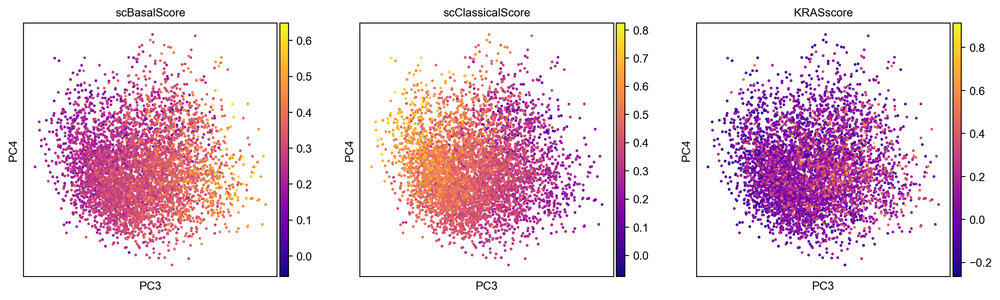

In [102]:
sc.pl.pca(adata, color=["scBasalScore","scClassicalScore","KRASscore"],dimensions=[(2,3)], cmap="plasma")

remove treatment

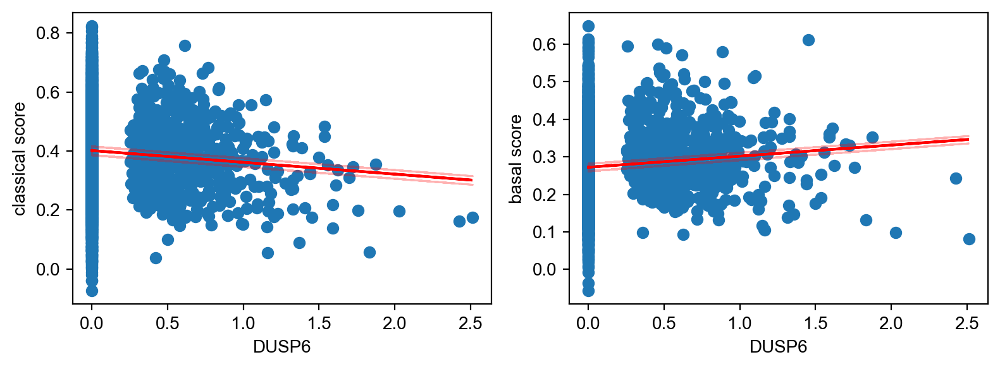

In [103]:
from scipy.stats import linregress





fig, ax = plt.subplots(1,2, figsize=(8, 3))
order = np.argsort(adata.obs["KRASscore"].values)

#k = adata.obs["KRASscore"]#[order]
k = np.asarray(adata[:,adata.var_names=="DUSP6"].X.todense()).flatten()
c = adata.obs["scClassicalScore"]#[order]
b = adata.obs["scBasalScore"]#[order]

ax[0].scatter(k,c)
ax[0].set_xlabel("DUSP6")
ax[0].set_ylabel("classical score")

# Calculate the linear regression parameters
slope, intercept, r_value, p_value, std_err = linregress(k, c)

# Plot the line of best fit
ax[0].plot(k, slope * k + intercept, color='red', label="Line of best fit")

confidence_interval = 1.96 * std_err  # 95% confidence interval

# Plot confidence interval
ax[0].fill_between(k, slope * k + intercept - confidence_interval, slope * k + intercept + confidence_interval, color='red', alpha=0.3, label="95% Confidence Interval")

ax[1].scatter(k,b)  
ax[1].set_xlabel("DUSP6")
ax[1].set_ylabel("basal score")

# Calculate the linear regression parameters
slope, intercept, r_value, p_value, std_err = linregress(k, b)

# Plot the line of best fit
ax[1].plot(k, slope * k + intercept, color='red', label="Line of best fit")
# Calculate confidence interval
confidence_interval = 1.96 * std_err  # 95% confidence interval

# Plot confidence interval
ax[1].fill_between(k, slope * k + intercept - confidence_interval, slope * k + intercept + confidence_interval, color='red', alpha=0.3, label="95% Confidence Interval")


plt.tight_layout()
plt.show()

In [104]:
from scipy import stats
print(stats.pearsonr(adata.obs["KRASscore"], adata.obs["scClassicalScore"]))
print(stats.pearsonr(adata.obs["KRASscore"], adata.obs["scBasalScore"]))


(-0.14998347905674803, 4.974475987683739e-27)
(0.23139201849704524, 6.315008123475159e-63)


In [106]:
adata#.obs

AnnData object with n_obs × n_vars = 5097 × 2098
    obs: 'MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig', 'pca_density_treatment', 'BasalNorm', 'ClassicalNorm', 'BasalNormZ', 'ClassicalNormZ', 'KRASscore'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'cellState_colors', '

In [113]:
scores = pd.DataFrame((k,c,b,adata.obs.cellState), index=[ 'KRASscore', 'scClassicalScore',"scBasalScore",'Classification']).T
scores

,KRASscore,scClassicalScore,scBasalScore,Classification
0,0.0,0.435376,0.140161,basal
1,0.0,0.278815,0.230224,basal
2,0.0,0.566037,0.198242,classical
3,0.0,0.488963,0.301037,basal
4,0.0,0.339231,0.238291,basal
...,...,...,...,...
5092,0.0,0.383473,0.279723,basal
5093,0.0,0.342752,0.269742,classical
5094,0.0,0.265544,0.201575,basal
5095,0.279585,0.301427,0.313982,basal


UFuncTypeError: Cannot cast ufunc 'svd_n_s' input from dtype('O') to dtype('float64') with casting rule 'same_kind'

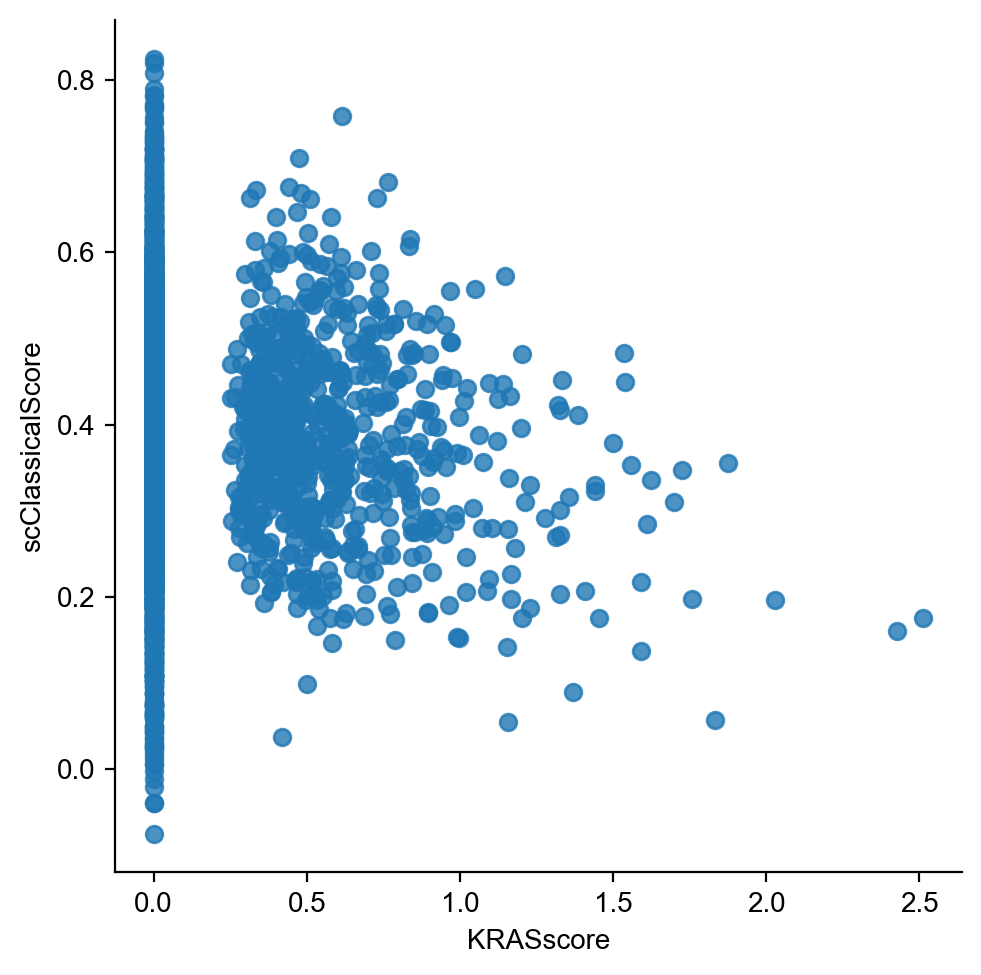

In [115]:
sns.lmplot(data = scores, x="KRASscore", y="scClassicalScore")#,hue="Classification")
sns.lmplot(data = scores, x="KRASscore", y="scBasalScore")#,hue="Classification")

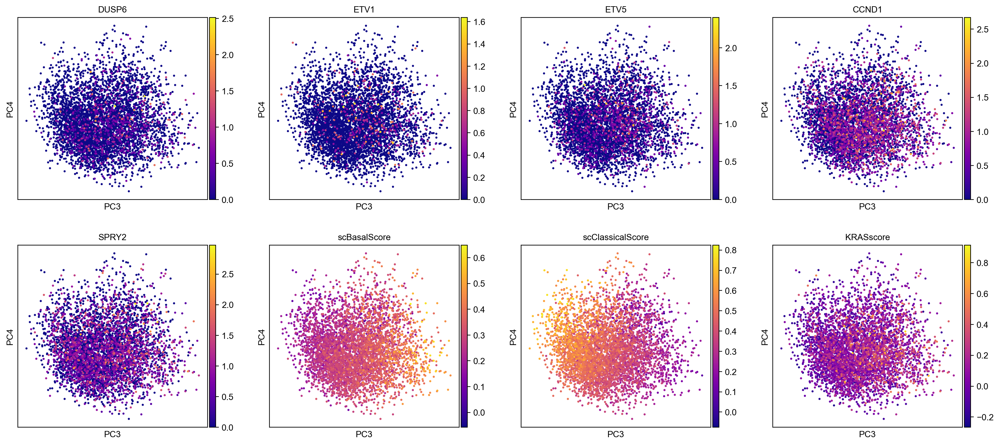

In [116]:
sc.pl.pca(adata, color=humanMarkers+["scBasalScore","scClassicalScore","KRASscore"],dimensions=[(2,3)], cmap="plasma")